# Lab 6 Report: 
## Audio Filtering with Gated RNNs

### Name: Van Tha Bik Lian

In [1]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import torch
import seaborn as sns
import IPython

from scipy.io.wavfile import write

In [2]:
from IPython.display import Image # For displaying images in colab jupyter cell

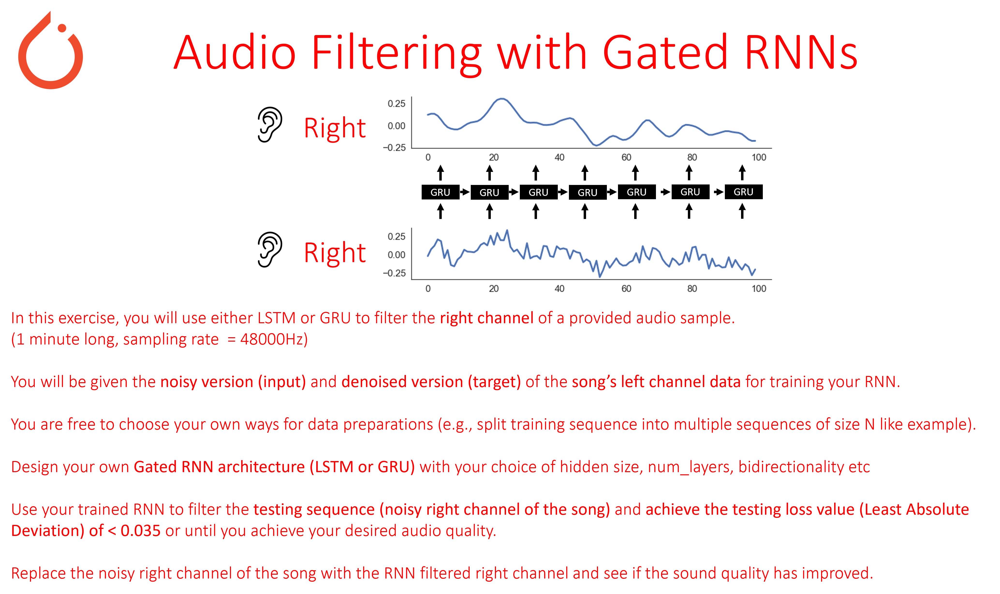

In [3]:
Image('lab6_exercise.png', width = 1000)

In [4]:
sns.set(style = 'white', font_scale = 1.5)

## Prepare Data

In [5]:
# Listen to audio with noisy right channel
# Our goal is to use RNN to denoise the right channel
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

import IPython
IPython.display.Audio("TSR_noisy.wav")

In [6]:
train_input_seqs = np.load('audio_train_inputs.npy') # Noisy left channel audio (training inputs to your RNN)
train_output_seqs = np.load('audio_train_targets.npy') # Ground truth left channel audio (trining targets for your RNN)

# Print the length of training features and targets
print(len(train_input_seqs), len(train_output_seqs))

2754000 2754000


In [7]:
# Reshape train_input_seqs and train_output_seqs to 2D arrays
# Each row corresponds to a single training input/target sequence
# e.g., if your training sequence length = 100 -> train_input_seqs/output_seqs should have shape (27540, 100)
# Feel free to choose your own training sequence length

# YOUR CODE HERE
train_input_seqs = train_input_seqs.reshape(int(train_input_seqs.shape[0]/150),150)
train_output_seqs = train_output_seqs.reshape(int(train_output_seqs.shape[0]/150),150)

In [8]:
print(train_input_seqs.shape, train_output_seqs.shape)

(18360, 150) (18360, 150)


In [9]:
# Reshape train_input_seqs and output_seqs again to conform to PyTorch (sample size (N), sequence length, # of features)

# YOUR CODE HERE
train_input_seqs = train_input_seqs.reshape((train_input_seqs.shape[0], -1, 1))
train_output_seqs = train_output_seqs.reshape((train_output_seqs.shape[0], -1, 1))

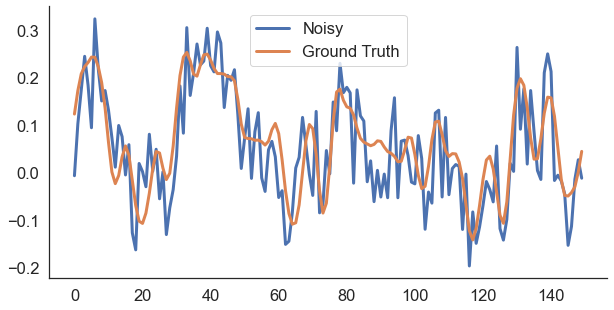

In [10]:
# let's plot one of the training input sequence/output target (10th sample)
# Feel free to plot a different sample

plt.figure(figsize = (10, 5))

plt.plot(train_input_seqs[100], label ='Noisy', linewidth = 3)
plt.plot(train_output_seqs[100], label ='Ground Truth', linewidth = 3)
plt.legend()
sns.despine()

## Define Model

In [11]:
class Denoiser_RNN(torch.nn.Module):
    
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        
        super(Denoiser_RNN, self).__init__()
        
        # YOUR CODE HERE
        self.gru = torch.nn.GRU(input_size=input_size, hidden_size=hidden_size,
                               num_layers=num_layers, batch_first=True,
                               bidirectional=True)
        self.decoder = torch.nn.Linear(2*hidden_size, output_size)
        self.output_activation = torch.nn.Tanh()
        
    def forward(self, input_seq, hidden_state):
        
        # YOUR CODE HERE
        denoised_seq, hidden = self.gru(input_seq, hidden_state)
        
        denoised_seq = self.output_activation(self.decoder(denoised_seq))
        
        return denoised_seq

In [12]:
# backup model - decided to not use because the GRU performed
# just as good as the LSTM in this case, and GRU took less time
class Denoiser_RNN_LSTM(torch.nn.Module):
    
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        
        super(Denoiser_RNN_LSTM, self).__init__()
        
        # YOUR CODE HERE
        self.gru = torch.nn.LSTM(input_size=input_size, hidden_size=hidden_size,
                               num_layers=num_layers, batch_first=True,
                               bidirectional=True)
        self.decoder = torch.nn.Linear(2*hidden_size, output_size)
        self.output_activation = torch.nn.Tanh()
        
    def forward(self, input_seq, hidden_state):
        
        # YOUR CODE HERE
        denoised_seq, hidden = self.gru(input_seq, hidden_state)
        
        denoised_seq = self.output_activation(self.decoder(denoised_seq))
        
        return denoised_seq

## Define Hyperparameters

In [13]:
# Define your model
denoiser_rnn = Denoiser_RNN(input_size = 1, hidden_size = 30, 
                            num_layers = 3, output_size = 1)

# Define lr and epochs
learning_rate = 0.0001 # YOUR CODE HERE      
epochs = 50 # YOUR CODE HERE

# Define mini-batch size
batchsize = 100 # YOUR CODE HERE

# Use L1Loss to minimize least absolute deviation + optimizer
loss_func = torch.nn.L1Loss()

optimizer = torch.optim.Adam(denoiser_rnn.parameters(), lr=learning_rate)

# Print out model specifics, add .cuda() if using GPU
if torch.cuda.is_available():
    denoiser_rnn = denoiser_rnn.cuda()

denoiser_rnn

Denoiser_RNN(
  (gru): GRU(1, 30, num_layers=3, batch_first=True, bidirectional=True)
  (decoder): Linear(in_features=60, out_features=1, bias=True)
  (output_activation): Tanh()
)

## Identify Tracked Values

In [14]:
# Empty list to keep track of training loss

train_loss_list = []

In [15]:
torch.cuda.is_available()

True

## Train Model

In [16]:
# Convert your training data into torch tensors and move to GPU if GPU is used
import tqdm

# YOUR CODE HERE
train_input_seqs = torch.from_numpy(train_input_seqs).float()
train_output_seqs = torch.from_numpy(train_output_seqs).float()

if torch.cuda.is_available():
    train_input_seqs = train_input_seqs.cuda()
    train_output_seqs = train_output_seqs.cuda()
    
# Split your training data into mini-batches
train_batches_features = torch.split(train_input_seqs, batchsize)
train_batches_targets = torch.split(train_output_seqs, batchsize)

# Total number of mini-batches in the training set
batch_split_num = len(train_batches_features)

for epoch in range(epochs):
    
    for k in tqdm.trange(batch_split_num):
        # initialize the hidden states as None
        hidden_state = None
        
        # Feed in k-th mini-batch training features to GRU + hidden states to produce output
        denoised_seq = denoiser_rnn(train_batches_features[k], hidden_state)
        
        # zero_grad() to clear gradient buffer
        optimizer.zero_grad()
        
        # Compute loss between the GRU denoised sequence vs target training sequence
        loss = loss_func(denoised_seq, train_batches_targets[k])
        # Append loss
        train_loss_list.append(loss.item())
        
        # Backpropagation
        loss.backward()
        
        # Update weights/biases
        optimizer.step()

    print("Averaged Training Loss for Epoch ", epoch,": ", np.mean(train_loss_list[-batch_split_num:]))

  2%|█▎                                                                                | 3/184 [00:00<00:06, 26.32it/s]

Averaged Training Loss for Epoch  0 :  0.13400203465362606


  1%|▉                                                                                 | 2/184 [00:00<00:09, 20.00it/s]

Averaged Training Loss for Epoch  1 :  0.047078593492345965


  2%|█▎                                                                                | 3/184 [00:00<00:07, 23.62it/s]

Averaged Training Loss for Epoch  2 :  0.04570980603887659


  1%|▉                                                                                 | 2/184 [00:00<00:10, 17.54it/s]

Averaged Training Loss for Epoch  3 :  0.04494270979953201


  1%|▉                                                                                 | 2/184 [00:00<00:10, 18.02it/s]

Averaged Training Loss for Epoch  4 :  0.044514767076496195


  2%|█▎                                                                                | 3/184 [00:00<00:08, 22.56it/s]

Averaged Training Loss for Epoch  5 :  0.04424694993371225


  1%|▉                                                                                 | 2/184 [00:00<00:10, 17.54it/s]

Averaged Training Loss for Epoch  6 :  0.04404313830942239


  2%|█▎                                                                                | 3/184 [00:00<00:06, 26.32it/s]

Averaged Training Loss for Epoch  7 :  0.04385205465571388


  2%|█▎                                                                                | 3/184 [00:00<00:06, 26.55it/s]

Averaged Training Loss for Epoch  8 :  0.04365481867495438


  2%|█▎                                                                                | 3/184 [00:00<00:09, 20.00it/s]

Averaged Training Loss for Epoch  9 :  0.04343361994656532


  2%|█▎                                                                                | 3/184 [00:00<00:06, 27.78it/s]

Averaged Training Loss for Epoch  10 :  0.04315302485559622


  1%|▉                                                                                 | 2/184 [00:00<00:09, 19.61it/s]

Averaged Training Loss for Epoch  11 :  0.04277320186931478


  1%|▉                                                                                 | 2/184 [00:00<00:09, 20.00it/s]

Averaged Training Loss for Epoch  12 :  0.04215874507739816


  2%|█▎                                                                                | 3/184 [00:00<00:06, 26.55it/s]

Averaged Training Loss for Epoch  13 :  0.04093198096582099


  1%|▉                                                                                 | 2/184 [00:00<00:10, 17.86it/s]

Averaged Training Loss for Epoch  14 :  0.038406671470274094


  1%|▉                                                                                 | 2/184 [00:00<00:10, 18.18it/s]

Averaged Training Loss for Epoch  15 :  0.03652945044450462


  2%|█▎                                                                                | 3/184 [00:00<00:06, 26.79it/s]

Averaged Training Loss for Epoch  16 :  0.03584594049733942


  2%|█▊                                                                                | 4/184 [00:00<00:09, 18.95it/s]

Averaged Training Loss for Epoch  17 :  0.03541323795671696


  1%|▉                                                                                 | 2/184 [00:00<00:09, 19.61it/s]

Averaged Training Loss for Epoch  18 :  0.0351178128697464


  1%|▉                                                                                 | 2/184 [00:00<00:09, 18.87it/s]

Averaged Training Loss for Epoch  19 :  0.03489668278590492


  2%|█▎                                                                                | 3/184 [00:00<00:07, 23.08it/s]

Averaged Training Loss for Epoch  20 :  0.03473332673108772


  2%|█▎                                                                                | 3/184 [00:00<00:07, 23.81it/s]

Averaged Training Loss for Epoch  21 :  0.034588768045701414


  1%|▉                                                                                 | 2/184 [00:00<00:11, 16.39it/s]

Averaged Training Loss for Epoch  22 :  0.034477388698850635


  2%|█▎                                                                                | 3/184 [00:00<00:08, 21.43it/s]

Averaged Training Loss for Epoch  23 :  0.03438079814710047


  2%|█▊                                                                                | 4/184 [00:00<00:06, 29.85it/s]

Averaged Training Loss for Epoch  24 :  0.03429726300680119


  2%|█▊                                                                                | 4/184 [00:00<00:09, 19.54it/s]

Averaged Training Loss for Epoch  25 :  0.034225683821284256


  2%|█▎                                                                                | 3/184 [00:00<00:06, 25.86it/s]

Averaged Training Loss for Epoch  26 :  0.03416302772846235


  2%|█▎                                                                                | 3/184 [00:00<00:07, 25.42it/s]

Averaged Training Loss for Epoch  27 :  0.03410935862516255


  2%|█▎                                                                                | 3/184 [00:00<00:09, 20.00it/s]

Averaged Training Loss for Epoch  28 :  0.03405952836265382


  2%|█▎                                                                                | 3/184 [00:00<00:07, 25.75it/s]

Averaged Training Loss for Epoch  29 :  0.034016204309528286


  1%|▉                                                                                 | 2/184 [00:00<00:10, 17.86it/s]

Averaged Training Loss for Epoch  30 :  0.03397826920263469


  1%|▉                                                                                 | 2/184 [00:00<00:10, 18.18it/s]

Averaged Training Loss for Epoch  31 :  0.0339413329999408


  2%|█▎                                                                                | 3/184 [00:00<00:07, 25.64it/s]

Averaged Training Loss for Epoch  32 :  0.03390848253975096


  1%|▉                                                                                 | 2/184 [00:00<00:10, 17.54it/s]

Averaged Training Loss for Epoch  33 :  0.033876695417110685


  2%|█▎                                                                                | 3/184 [00:00<00:07, 25.42it/s]

Averaged Training Loss for Epoch  34 :  0.03385388522165949


  2%|█▎                                                                                | 3/184 [00:00<00:07, 22.73it/s]

Averaged Training Loss for Epoch  35 :  0.03382775578242929


  1%|▉                                                                                 | 2/184 [00:00<00:11, 15.62it/s]

Averaged Training Loss for Epoch  36 :  0.033799253140940615


  2%|█▎                                                                                | 3/184 [00:00<00:06, 27.03it/s]

Averaged Training Loss for Epoch  37 :  0.033775863531248076


  1%|▉                                                                                 | 2/184 [00:00<00:10, 17.24it/s]

Averaged Training Loss for Epoch  38 :  0.03375308533482577


  1%|▉                                                                                 | 2/184 [00:00<00:09, 18.69it/s]

Averaged Training Loss for Epoch  39 :  0.033728715740954096


  2%|█▎                                                                                | 3/184 [00:00<00:07, 25.42it/s]

Averaged Training Loss for Epoch  40 :  0.03371100704712064


  1%|▉                                                                                 | 2/184 [00:00<00:11, 16.39it/s]

Averaged Training Loss for Epoch  41 :  0.03368648106191793


  2%|█▎                                                                                | 3/184 [00:00<00:07, 24.39it/s]

Averaged Training Loss for Epoch  42 :  0.03367078847899709


  2%|█▎                                                                                | 3/184 [00:00<00:08, 22.39it/s]

Averaged Training Loss for Epoch  43 :  0.033649455442133804


  1%|▉                                                                                 | 2/184 [00:00<00:10, 16.95it/s]

Averaged Training Loss for Epoch  44 :  0.0336343449358221


  2%|█▎                                                                                | 3/184 [00:00<00:06, 25.86it/s]

Averaged Training Loss for Epoch  45 :  0.033618704102042575


  1%|▉                                                                                 | 2/184 [00:00<00:10, 18.18it/s]

Averaged Training Loss for Epoch  46 :  0.0335998787726883


  1%|▉                                                                                 | 2/184 [00:00<00:10, 17.24it/s]

Averaged Training Loss for Epoch  47 :  0.033587787330717496


  2%|█▎                                                                                | 3/184 [00:00<00:06, 26.32it/s]

Averaged Training Loss for Epoch  48 :  0.03357597142862885


100%|████████████████████████████████████████████████████████████████████████████████| 184/184 [00:08<00:00, 21.69it/s]

Averaged Training Loss for Epoch  49 :  0.033562697399326644


## Visualize & Evaluate Model

### Visualizing Training Loss

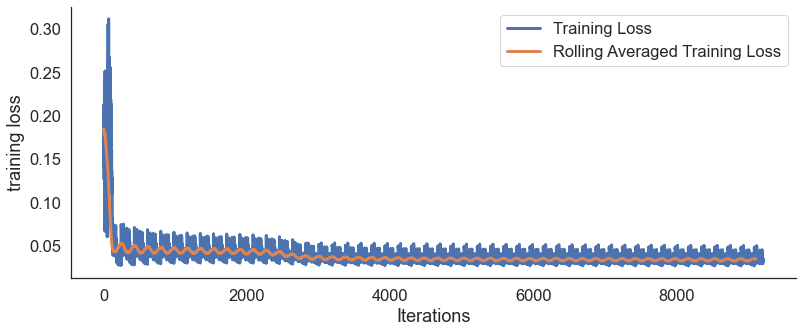

In [18]:
# Plot your training loss throughout the training 

plt.figure(figsize = (13, 5))

plt.plot(train_loss_list, linewidth = 3, label = 'Training Loss')
plt.plot(np.convolve(train_loss_list, np.ones(100), 'valid') / 100, 
         linewidth = 3, label = 'Rolling Averaged Training Loss')

plt.ylabel("training loss")
plt.xlabel("Iterations")
plt.legend()
sns.despine()

### Computing Testing Loss

In [19]:
# Load test features (Noisy right channel) and test targets for computing the test loss|
test_input_seqs = np.load('audio_test_inputs.npy') # Noisy right channel audio (to be used as inputs to your trained RNN)
test_output_seqs = np.load('audio_test_targets.npy') # Groundtruth right channel audio (to compute the test loss)

In [20]:
# Test features/targets have same dimension as training feature/targets

print(len(test_input_seqs), len(test_output_seqs))

2754000 2754000


In [21]:
# Convert your test_input_seqs and output_seqs into torch tensors
# YOUR CODE HERE
test_input_seqs = torch.from_numpy(test_input_seqs).float()
test_output_seqs = torch.from_numpy(test_output_seqs).float()

# Reshape your test_input_seqs and output_seqs to 2D arrays as you did with train_input_seqs and output_seqs
# YOUR CODE HERE
test_input_seqs = test_input_seqs.reshape(int(test_input_seqs.shape[0]/150), 150)
test_output_seqs = test_output_seqs.reshape(int(test_output_seqs.shape[0]/150), 150)

# Reshape the test_input_seqs and output_seqs again to conform to (sample size (N), sequence length, # of features)
# YOUR CODE HERE
test_input_seqs = test_input_seqs.reshape((test_input_seqs.shape[0], -1, 1))
test_output_seqs = test_output_seqs.reshape((test_output_seqs.shape[0], -1, 1))

In [22]:
# Each noisy test input sequence is fed into your trained RNN to produce denoised outputs
# We need to take mini-batch approach since our test_features is too big to feed it all in once (i.e. not enough memory)

if torch.cuda.is_available():
    test_input_seqs = test_input_seqs.cuda()
    test_output_seqs = test_output_seqs.cuda()
# Split the test_features and targets to mini-batches
test_batches_features = torch.split(test_input_seqs, batchsize)
test_batches_targets = torch.split(test_output_seqs, batchsize)

batch_split_num_test = len(test_batches_features)

# Empty lists to keep track of RNN denoised test sequences and test losses
test_prediction = []
test_losses = []

# Turn on no_grad() since we aren't performing backprop during this process
with torch.no_grad():
    
    for k in range(batch_split_num_test):
        
        # Feed in k-th test mini-batch to trained RNN
        test_pred = denoiser_rnn(test_batches_features[k], None)
        # Compre the test_pred with test target sequence to compute testing loss
        test_loss = loss_func(test_pred, test_batches_targets[k])
        
        # Use torch.squeeze() to make test_pred to shape (batchsize, seq_len) and convert it to numpy array
        
        if torch.cuda.is_available():
            test_pred = test_pred.cpu() 
        
        test_pred_numpy = torch.squeeze(test_pred).numpy()
        
        # Append both test_pred_numpy and test_loss 
        test_prediction.append(test_pred_numpy)
        test_losses.append(test_loss.item())
        
# Final testing loss is the average of all the test_losses from mini-batches        
print("Testing Loss (Least Absolute Deviations): ", np.mean(test_losses))

Testing Loss (Least Absolute Deviations):  0.03477626045882378


### Creating a new audio with denoised right channel sequence

In [23]:
# test_prediction is a list of 2D arrays where each array has shape (batchsize, seq_len)
# Vertically stack all appended 2D arrays so that we have a single 2D array
test_prediction = np.vstack(test_prediction)

# move test_output_seqs in GPU to CPU
if torch.cuda.is_available():
    test_output_seqs = test_output_seqs.cpu()

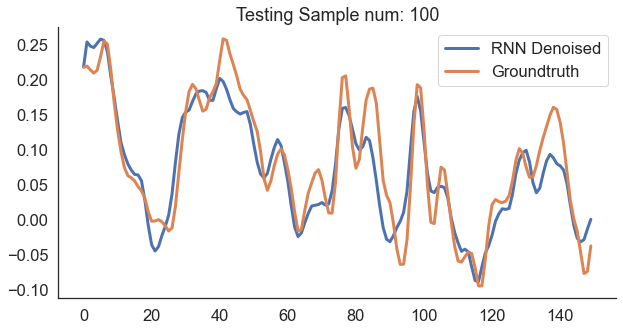

In [24]:
# We can visualize RNN denoised test sequence vs ground truth test sequence for particular sample
test_sample_num = 100 # SOME INTEGER HERE
    
plt.figure(figsize = (10, 5))

plt.plot(test_prediction[test_sample_num], label='RNN Denoised', linewidth = 3)
plt.plot(test_output_seqs[test_sample_num], label='Groundtruth', linewidth = 3)
plt.legend()
plt.title("Testing Sample num: {}".format(test_sample_num))
sns.despine()

In [25]:
# move test_output_seqs in GPU to CPU
if torch.cuda.is_available():
    train_output_seqs = train_output_seqs.cpu()

In [26]:
# Reshape the test_prediction to 1D array of size 2754000 so that we can use it as the right channel of the song
# YOUR CODE HERE
test_prediction = test_prediction.flatten()

# Reshape the train_output_seqs (ground truth left channel of the song) to 1D array as well
# YOUR CODE HERE
train_output_seqs = train_output_seqs.flatten()
# Construct an array 'fixed_audio' of size (2754000, 2) 
# where the first column (left channel) is 1D reshaped train_output_seqs (groundtruth left channel)
# And second column (right channel) is the 1D reshaped test_prediction (RNN denoised)

fixed_audio = np.column_stack((train_output_seqs, test_prediction))

In [27]:
print(test_prediction.flatten, train_output_seqs.shape)

<built-in method flatten of numpy.ndarray object at 0x000001B01C26DA50> torch.Size([2754000])


In [28]:
fixed_audio.shape

(2754000, 2)

In [29]:
# Scale the fixed_audio so that it's in int16 form and write it into a new audio file

scaled = np.int16(fixed_audio/np.max(np.abs(fixed_audio)) * 32767)
write('TSR_fixed.wav', 48000, scaled)

In [30]:
# Listen to the new audio with denoised right channel
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

IPython.display.Audio("TSR_fixed.wav")

In [31]:
# Compare your denoised audio with ground truth audio for reference
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

IPython.display.Audio("TSR.wav")